In [1]:
# pip install -q -U keras-tuner

# Import required libraries

In [2]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import keras 
from keras.models import Sequential
from keras.layers import Conv2D, Dense, MaxPool2D, Dropout, Flatten, Activation, MaxPooling2D, GlobalAveragePooling2D
from tensorflow.keras.optimizers import Adam
from sklearn.model_selection import KFold
import numpy as np
import tensorflow as tf
import keras_tuner as kt
from keras.models import Model
from tensorflow.keras.applications.resnet50 import ResNet50
from keras.layers import Lambda, Input
from tensorflow.keras.applications.vgg16 import VGG16
from tensorflow.keras.applications.vgg16 import preprocess_input
from tensorflow.keras import models, layers

# Read train dataset and prepare the data for the models

In [3]:
# read the train csv file and save its content in a dataframe
data_train = pd.read_csv('../input/project2deep/fashion-mnist_train.csv')
data_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 60000 entries, 0 to 59999
Columns: 785 entries, label to pixel784
dtypes: int64(785)
memory usage: 359.3 MB


In [4]:
# view the describtion of the dataset to see the count, mean, min, standrard deviation, and more
data_train.describe()

,label,pixel1,pixel2,pixel3,pixel4,pixel5,pixel6,pixel7,pixel8,pixel9,...,pixel775,pixel776,pixel777,pixel778,pixel779,pixel780,pixel781,pixel782,pixel783,pixel784
count,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,...,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.000000,60000.00000
mean,4.500000,0.000900,0.006150,0.035333,0.101933,0.247967,0.411467,0.805767,2.198283,5.682000,...,34.625400,23.300683,16.588267,17.869433,22.814817,17.911483,8.520633,2.753300,0.855517,0.07025
std,2.872305,0.094689,0.271011,1.222324,2.452871,4.306912,5.836188,8.215169,14.093378,23.819481,...,57.545242,48.854427,41.979611,43.966032,51.830477,45.149388,29.614859,17.397652,9.356960,2.12587
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
25%,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
50%,4.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
75%,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,58.000000,9.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.00000
max,9.000000,16.000000,36.000000,226.000000,164.000000,227.000000,230.000000,224.000000,255.000000,254.000000,...,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,255.000000,170.00000


In [5]:
# check whether there is null values or not and get its number if exist
print('number of null values in data_train = ', data_train.isna().sum().sum())

number of null values in data_train =  0


In [6]:
# check whether there is duplicate values or not and get its number if exist
print('number of duplicated values in data_train = ', data_train.duplicated(keep='first').sum())

number of duplicated values in data_train =  43


In [7]:
# drop the duplicated rows from the training dataframe
data_train = data_train.drop_duplicates(keep=False)

In [8]:
# just a check to make sure that there is no duplicate rows
print('number of duplicated values in data_train = ', data_train.duplicated(keep='first').sum())

number of duplicated values in data_train =  0


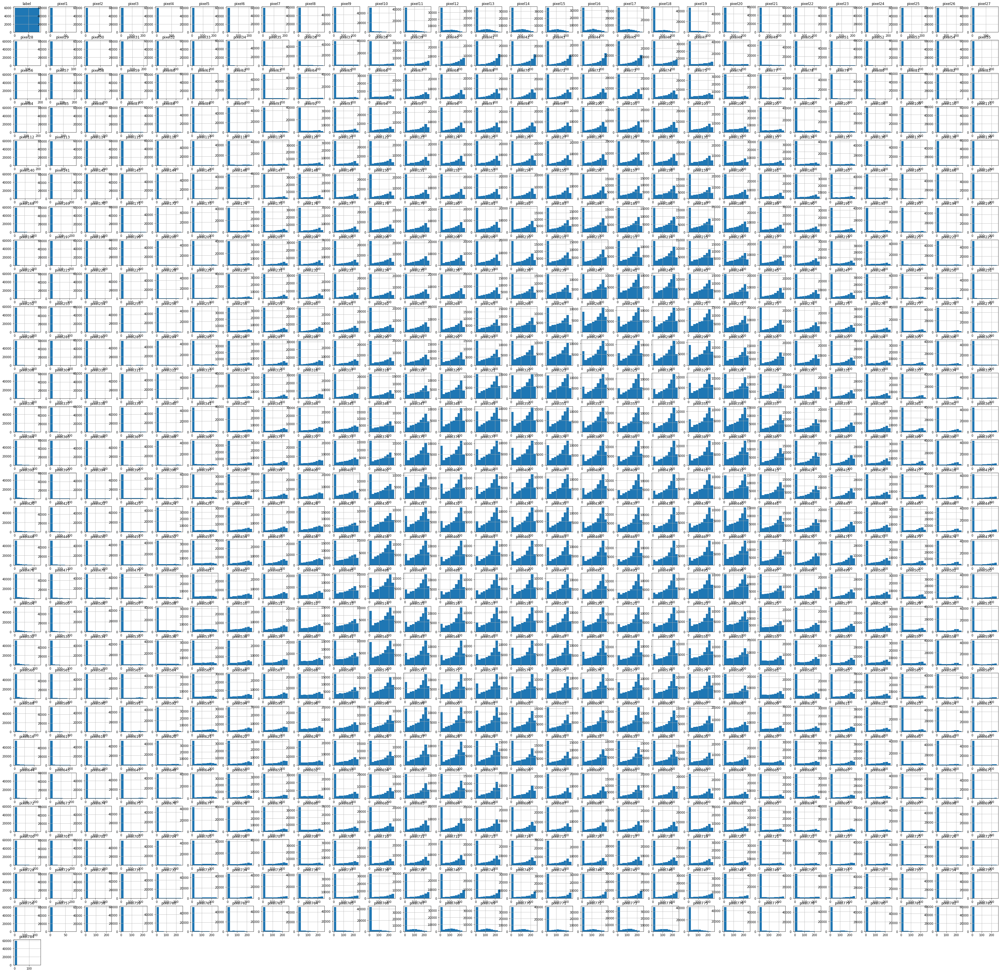

In [9]:
# plot histogram for the features and the label with 10 bins for each one
data_train.hist(bins=10, figsize=(60,60))
plt.show()

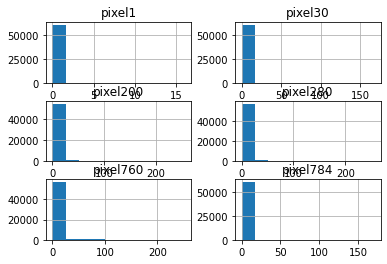

In [10]:
# plot a clear histogram for 3 features from the dataset
data_train.hist(column=['pixel1','pixel30','pixel200','pixel280', 'pixel760', 'pixel784']);

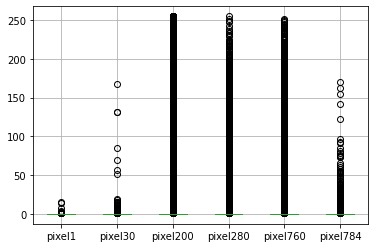

In [11]:
# Box plot for some features
boxplot = data_train.boxplot(column=['pixel1','pixel30','pixel200','pixel280', 'pixel760', 'pixel784'])

In [12]:
# get the correlation values of the features in the training dataframe and the labels
data_train.corr

<bound method DataFrame.corr of        label  pixel1  pixel2  pixel3  pixel4  pixel5  pixel6  pixel7  pixel8  \
0          2       0       0       0       0       0       0       0       0   
1          9       0       0       0       0       0       0       0       0   
2          6       0       0       0       0       0       0       0       5   
3          0       0       0       0       1       2       0       0       0   
4          3       0       0       0       0       0       0       0       0   
...      ...     ...     ...     ...     ...     ...     ...     ...     ...   
59995      9       0       0       0       0       0       0       0       0   
59996      1       0       0       0       0       0       0       0       0   
59997      8       0       0       0       0       0       0       0       0   
59998      8       0       0       0       0       0       0       0       0   
59999      7       0       0       0       0       0       0       0       0   

       

In [13]:
# get the correlation map between all features and the labels
corr = data_train.corr()
corr.style.background_gradient(cmap='coolwarm')

In [14]:
# split the features and the label in the training phase to be used in the supervised learning in the models
x_train = data_train.drop("label",axis=1)
y_train = data_train["label"]

In [15]:
# get the number of each category in the labels to check whether there is balance in the data or not
y_train.value_counts()

5    6000
8    6000
9    5996
0    5996
3    5994
7    5992
1    5992
4    5990
6    5978
2    5976
Name: label, dtype: int64

/opt/conda/lib/python3.7/site-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


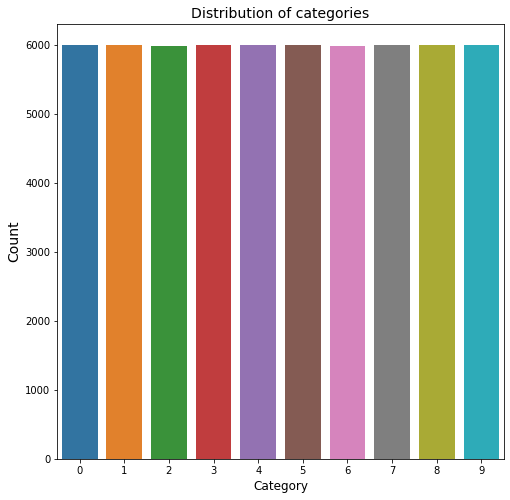

In [16]:
# plot the distribution of the different categories of the clothes
fig, ax = plt.subplots(figsize=(8,8))
sns.countplot(y_train)
ax.set_title('Distribution of categories', fontsize=14)
ax.set_xlabel('Category', fontsize=12)
ax.set_ylabel('Count', fontsize=14)
plt.show()

This means that there is balance in the weights of each class in the data.

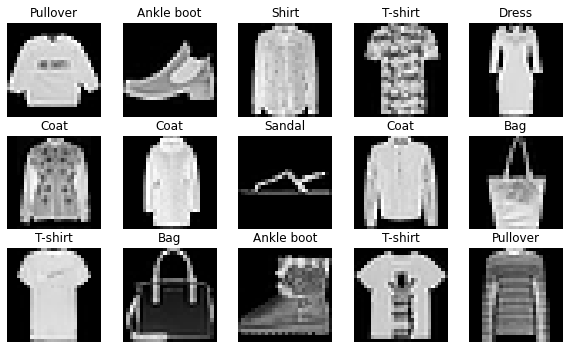

In [17]:
# view random images from the training images, each image with its label (name)
# make list for the labels with their names 
names = ["T-shirt","Trouser","Pullover","Dress","Coat","Sandal","Shirt","Sneaker","Bag","Ankle boot"]
plt.figure(figsize=(10,10))
for i in range(15):
    plt.subplot(5,5,i+1)
    plt.imshow(x_train.iloc[i].values.reshape((28,28)),cmap="gray")
    index = int(y_train[i])
    plt.axis("off")
    plt.title(names[index])
plt.show()    

# Read test dataset and prepare the data for the models

In [18]:
# read the test data and display the information about this dataframe
data_test = pd.read_csv('../input/project2deep/fashion-mnist_test.csv')
data_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Columns: 785 entries, label to pixel784
dtypes: int64(785)
memory usage: 59.9 MB


In [19]:
# split the features and labels in the test dataframe
x_test = data_test.drop("label",axis=1)
y_test = data_test["label"]

In [20]:
# create arrays from the features and labels in the training dataframe
x_train2 = np.array(x_train)
y_train2= np.array(y_train)

In [21]:
# create arrays from the features and labels in the test dataframe
x_test2 = np.array(x_test)
y_test2= np.array(y_test)

In [22]:
# Normalize the features in the training and test as the features have different ranges from 0 to 255
x_train2 = x_train2 / 255.0
x_test2 = x_test2 / 255.0

In [23]:
# Reshape the input features in the training and test to make them as images with 1 channel with size 28x28
X_train_reshaped = x_train2.reshape(x_train2.shape[0], 28, 28, 1)
X_test_reshaped = x_test2.reshape(x_test2.shape[0], 28, 28, 1)
X_train_reshaped.shape

(59914, 28, 28, 1)

In [24]:
# make encode for the labels as there are 10 classes in this dataset in the training and test
from tensorflow.keras.utils import to_categorical
num_classes = 10
y_train2=to_categorical(y_train2,num_classes)
y_test2=to_categorical(y_test2,num_classes)
y_train2.shape

(59914, 10)

# Starting for part 2
# The models

In [25]:
# define a function to plot the results from the model that takes 2 arguments: history and number of the fold in the 
# cross-validation
def plt_function_single_op(history, k):
# split the horizontal area to draw the two plots horizontaly
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12,4))
    fig.suptitle('Model Results for fold number = {}'.format(k))

    # plot the accuracy through the training and validation
    ax1.plot(history.history['accuracy'])
    ax1.plot(history.history['val_accuracy'])
    ax1.set_title('Model accuracy')
    ax1.set_ylabel('Accuracy')
    ax1.set_xlabel('Epoch')
    ax1.legend(['training accuracy', 'validation accuracy'], loc='lower right')
    ax1.grid()

    # plot the loss through the training and validation
    ax2.plot(history.history['loss'])
    ax2.plot(history.history['val_loss'])
    ax2.set_title('Model loss')
    ax2.set_ylabel('Loss')
    ax2.set_xlabel('Epoch')
    ax2.legend(['training loss', 'validation loss'], loc='upper left')
    ax2.grid()

## Build the LeNet 5 model
### Using cross validation with 5 folds

Our model will take the input shape as (28, 28, 1). 

Our model consists from convolution layer with filter size 5x5, activation: ReLU, and with making padding for the input to get the output with the same size of the input. 

So according to the equation to get the shape we will have ((N + 2P - F) / S) + 1 = ((28 + 4 - 5) / 1) + 1 = 28 x 28. With applying 32 filter so the output size from this layer is 28x28x32.

Then the second layer is Max pooling with stride = 2 to make dimensionality reduction, so the output shape is ((N + 2P -F) / S) + 1 = ((28 - 2) / 2) + 1 = 14 x 14 x 32.

Then third layer is convolution with filters = 48, and kernel size = 5x5, and padding valid which means that there is no padding. So, the output shape is ((N + 2P - F) / S) + 1 = ((14 - 5) / 1) + 1 = 10 x 10 x 48.

Then in the fourth layer, Max pooling with stride = 2, so the output shape is = ((N + 2P -F) / S) + 1 = ((10 - 2) / 2) + 1 = 5 x 5 x 48. 

Then we will make flatten for the results from the previous layer to use the results with some dense layers. 

In the first layer in the dense layers, we used automated tuning to get the best number of the hidden units in it, by using ‘keras tuner’. Then the next layer with 84 hidden units, then the next one with 10 units, and this is our output layer. As we have 10 categories, so we need 10 units in the last dense layer with activation = ‘softmax’ as it is multi-classification problem. In the dense layers, weights according to the number of units multiplied by the output of the previous layer, and bias by shape number of units multiplied by 1. As each unit has its bias. So, for example the last dense layer will have weights by shape = 84x10, and bias by shape = 10x1.

In the model compilation, we will use adam optimizer with tune its learning rate, loss = 'categorical_crossentropy' as we have multi categories, and accuracy metric.


In [26]:
# here we will tune the learning rate and number of hidden units
def model_builder(hp):
    model = Sequential()
    model.add(Conv2D(filters=32, kernel_size=(5,5), padding='same', activation='relu', input_shape=(28, 28, 1)))
    model.add(MaxPool2D(strides=2))
    model.add(Conv2D(filters=48, kernel_size=(5,5), padding='valid', activation='relu'))
    model.add(MaxPool2D(strides=2))
    model.add(Flatten())
    
    # Tune the number of units in the first Dense layer
    # Choose an optimal value between 120-512 with step = 32 in each time
    hp_units = hp.Int('units', min_value=120, max_value=512, step=32)
    model.add(keras.layers.Dense(units=hp_units, activation='relu'))
    model.add(Dense(84, activation='relu'))
    model.add(Dense(10, activation='softmax'))

    model.build()
    model.summary()
    
    # Tune the learning rate for the optimizer
    # Choose an optimal value from 0.01, 0.001, or 0.0001
    hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3, 1e-4])

    model.compile(optimizer=Adam(learning_rate=hp_learning_rate),
                loss='categorical_crossentropy',
                metrics=['accuracy'])

    return model

In [27]:
# build the tuner model with making its objective = val_accuracy to trace it and save the results from the tuning process in 
# a folder with name: intro_to_kt inside a folder names: my_dir
tuner = kt.Hyperband(model_builder,
                     objective='val_accuracy',
                     max_epochs=15,
                     factor=3,
                     directory='my_dir',
                     project_name='intro_to_kt')

2022-04-06 17:53:12.710834: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 28, 28, 32)        832       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 10, 10, 48)        38448     
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 5, 5, 48)          0         
_________________________________________________________________
flatten (Flatten)            (None, 1200)              0         
_________________________________________________________________
dense (Dense)                (None, 120)               144120    
_________________________________________________________________
dense_1 (Dense)              (None, 84)                1

2022-04-06 17:53:12.791463: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-04-06 17:53:12.792143: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2022-04-06 17:53:12.793292: I tensorflow/core/platform/cpu_feature_guard.cc:142] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 AVX512F FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2022-04-06 17:53:12.794403: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA 

In [28]:
# define the early stop to prevent the overfitting
stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)

In [29]:
tuner.search(X_train_reshaped, y_train2, epochs=50, validation_split=0.2, callbacks=[stop_early])

# Get the optimal hyperparameters
best_hps=tuner.get_best_hyperparameters(num_trials=1)[0]

print(f"""
The hyper-parameter search is done. The optimal number of units in the first dense layer in the fully connected layer is 
{best_hps.get('units')} and the optimal learning rate for the Adam optimizer is {best_hps.get('learning_rate')}.
""")

Trial 30 Complete [00h 02m 30s]
val_accuracy: 0.9089543223381042

Best val_accuracy So Far: 0.9172995090484619
Total elapsed time: 00h 21m 00s

The hyper-parameter search is done. The optimal number of units in the first dense layer in the fully connected layer is 
248 and the optimal learning rate for the Adam optimizer is 0.001.



In [30]:
num_folds = 5
# make two empty arrays to save the results in each fold from the 5 cross-validation process
acc_per_fold = []
loss_per_fold = []

In [31]:
# Define the K-fold Cross Validator
kfold = KFold(n_splits=num_folds, shuffle=True)

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_2 (Conv2D)            (None, 28, 28, 32)        832       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_3 (Conv2D)            (None, 10, 10, 48)        38448     
_________________________________________________________________
max_pooling2d_3 (MaxPooling2 (None, 5, 5, 48)          0         
_________________________________________________________________
flatten_1 (Flatten)          (None, 1200)              0         
_________________________________________________________________
dense_3 (Dense)              (None, 248)               297848    
_________________________________________________________________
dense_4 (Dense)              (None, 84)               

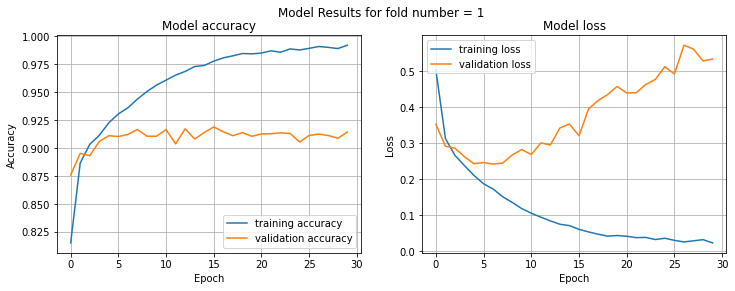

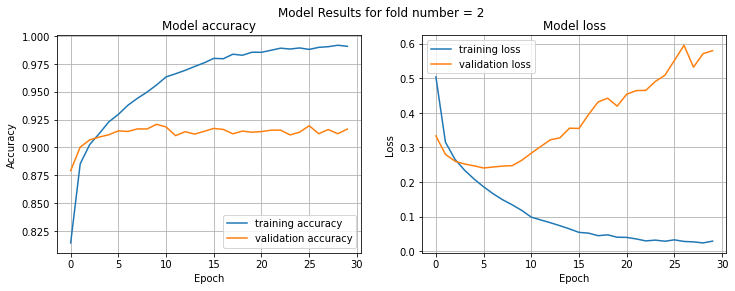

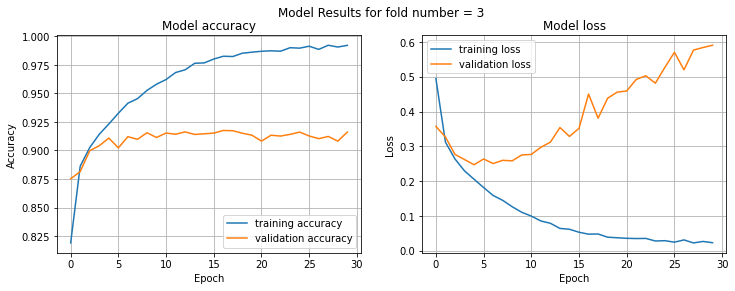

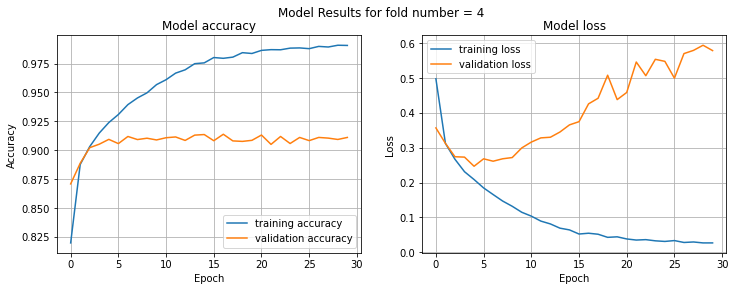

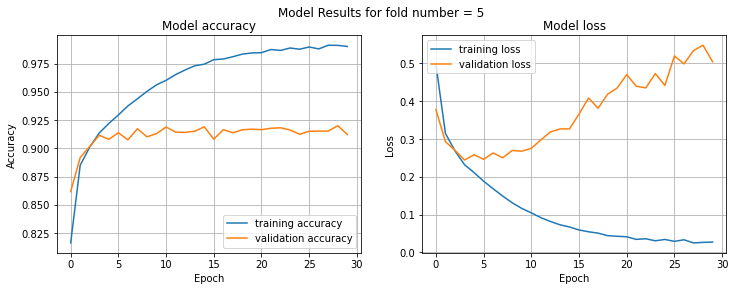

In [32]:
# initliaze the fold number
fold_no = 1
# loop across the folds and each iteration get the train, and validate (test) part to be used in the training
for train, test in kfold.split(X_train_reshaped, y_train2):
    # Build the model with the optimal hyperparameters we got from tuning the model and train it on the data for 30 epochs
    model = tuner.hypermodel.build(best_hps)
    # print the start of each epoch
    print('------------------------------------------------------------------------')
    print(f'Training for fold {fold_no}')
    # Fit data to the model with the train part and validate the model with the validate (test) part from the splitting in the
    # cross-validation
    history = model.fit(X_train_reshaped[train], y_train2[train],
                    validation_data=(X_train_reshaped[test], y_train2[test]),
                      batch_size= 64,
                      epochs= 30,
                      verbose= 1)
    # call the function that plot the results of the history with give it the history and the number of the fold
    plt_function_single_op(history, fold_no)
    # evaluate the model using the test features and test labels and print the results
    scores = model.evaluate(X_test_reshaped, y_test2, verbose=0)
    print(f'Score for fold {fold_no}: {model.metrics_names[0]} of {scores[0]}; {model.metrics_names[1]} of {scores[1]*100}%')
    # append in the array the results appeared in each iteration
    acc_per_fold.append(scores[1] * 100)
    loss_per_fold.append(scores[0])

    # increment the fold number
    fold_no = fold_no + 1
    

In [33]:
# print the final results through each iteration and the mean through all iterations 
print('Score per fold')
for i in range(0, len(acc_per_fold)):
    print(f'Fold {i+1} - Loss: {loss_per_fold[i]} - Accuracy: {acc_per_fold[i]}%')
print('------------------------------------------------------------------------')
print('Average scores over all folds:')
print(f'Accuracy: {np.mean(acc_per_fold)} (+- {np.std(acc_per_fold)})')
print(f'Loss: {np.mean(loss_per_fold)}')

Score per fold
Fold 1 - Loss: 0.5063352584838867 - Accuracy: 91.64000153541565%
Fold 2 - Loss: 0.5232449173927307 - Accuracy: 91.9700026512146%
Fold 3 - Loss: 0.5221113562583923 - Accuracy: 92.22999811172485%
Fold 4 - Loss: 0.5250310897827148 - Accuracy: 91.68999791145325%
Fold 5 - Loss: 0.4921169877052307 - Accuracy: 91.46000146865845%
------------------------------------------------------------------------
Average scores over all folds:
Accuracy: 91.79800033569336 (+- 0.27095322610688594)
Loss: 0.5137679219245911


 # First model with transfer learning with ResNet

In [34]:
# check the shape of the features 
x_train.shape

(59914, 784)

In [35]:
# reshape to input in file train
X = x_train.values.reshape(-1,28,28,)
# reshape to input in file test
X_test = x_test.values.reshape(-1,28,28,)
X.shape

(59914, 28, 28)

In [36]:
# reshape the labels in the training and test then make stack for the arrays
y =y_train.values.reshape(-1,1,1)
y=np.stack((y,)*1, axis=-1)
y_test =y_test.values.reshape(-1,1,1)
y_test=np.stack((y_test,)*1, axis=-1)

In [37]:
#convert output labels to numerical in the train
y = to_categorical(y,num_classes=10)
#convert output labels to numerical in the test 
y_test = to_categorical(y_test,num_classes=10)

In [38]:
# make stack for the arrays in the training and test, making joining for the sequence of the array of each image on the
# last dimension to be the axis, as the axis = -1
X = np.stack((X,)*3, axis=-1)
X_test = np.stack((X_test,)*3, axis=-1)
X.shape

(59914, 28, 28, 3)

In [39]:
# convert from integers to floats
x_norm = X.astype('float32')
test_norm = X_test.astype('float32')
# normalize to range 0-1
X_normalized = x_norm / 255.0
X_test_normalized = test_norm / 255.0

In [40]:
# Resnet Model load its pre-trained weights and remove the lost fully connected layer to add one suitable with our problem
model = ResNet50(classes=10,include_top=False,weights='imagenet',input_tensor=Input(shape=(28, 28, 3)))

# Freeze all the layers
for layer in model.layers[:]:
    layer.trainable = False

# then the last fully connected layer with the first dense layer with 128 units and activation= ReLU    
# Add Dense layer to classify on our fashion mnist dataset with output layer has 10 units as we have multiclass problem with 
# 10 categories
output = model.output
output = Dense(units=128, activation='relu')(output)
output = Dense(units=10, activation='softmax')(output)
model = Model(model.input, output)
# compile the model with the parameters we need
model.compile(loss='categorical_crossentropy',
              optimizer='adam',
              metrics=['accuracy'])

94781440/94765736 [==============================] - 1s 0us/step


In [41]:
# fit the model on the training data we have with taking 20% of the data to validate the model
history = model.fit(X_normalized, y, epochs=30, batch_size=64,  validation_split=0.2)

Epoch 1/30
749/749 [==============================] - 19s 22ms/step - loss: 0.9485 - accuracy: 0.6681 - val_loss: 0.7400 - val_accuracy: 0.7266
Epoch 2/30
749/749 [==============================] - 16s 21ms/step - loss: 0.6803 - accuracy: 0.7426 - val_loss: 0.6452 - val_accuracy: 0.7581
Epoch 3/30
749/749 [==============================] - 15s 20ms/step - loss: 0.6275 - accuracy: 0.7617 - val_loss: 0.6402 - val_accuracy: 0.7581
Epoch 4/30
749/749 [==============================] - 15s 20ms/step - loss: 0.6005 - accuracy: 0.7741 - val_loss: 0.6601 - val_accuracy: 0.7502
Epoch 5/30
749/749 [==============================] - 16s 21ms/step - loss: 0.5815 - accuracy: 0.7791 - val_loss: 0.6057 - val_accuracy: 0.7775
Epoch 6/30
749/749 [==============================] - 15s 20ms/step - loss: 0.5681 - accuracy: 0.7839 - val_loss: 0.5701 - val_accuracy: 0.7857
Epoch 7/30
749/749 [==============================] - 16s 21ms/step - loss: 0.5530 - accuracy: 0.7909 - val_loss: 0.5680 - val_accuracy:

In [42]:
# evaluate the model with the test data
score = model.evaluate(X_test_normalized, y_test)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

313/313 [==============================] - 5s 16ms/step - loss: 0.4817 - accuracy: 0.8198
Test loss: 0.4817449152469635
Test accuracy: 0.8198000192642212


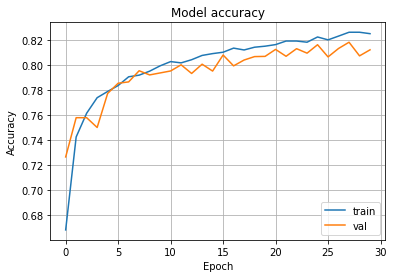

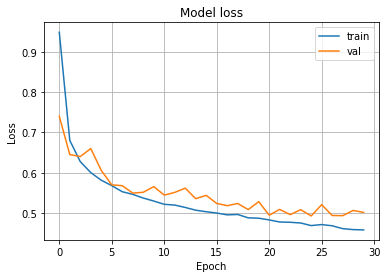

In [43]:
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc='lower right')
plt.grid()
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc='upper right')
plt.grid()
plt.show()

# Second model with transfer learning with VGG 16

In [44]:
# resize the images to be prepared for the VGG 16 model as the least size that it can work on is 48x48
from keras.preprocessing.image import img_to_array, array_to_img

X = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in X])
X_test = np.asarray([img_to_array(array_to_img(im, scale=False).resize((48,48))) for im in X_test])

In [45]:
# convert from integers to floats
x_norm = X.astype('float32')
test_norm = X_test.astype('float32')
# normalize to range 0-1
X = x_norm / 255.0
X_test = test_norm / 255.0

In [46]:
# VGG16 Model load its pre-trained weights and remove the lost fully connected layer to add one suitable with our problem
model = VGG16(classes=10,include_top=False,weights='imagenet', input_shape=(48,48,3))


# Freeze all the layers
for layer in model.layers[:]:
    layer.trainable = False

# Add Dense layer as in VGG16
#first flatten the output from the previous layer as the fully connected layers deal with flatten arrays not images.
# Then, in the last fully connected layer, we made the first dense layer with 4096 units and activation= ReLU. 
# Then the next dense layer with 4096 units and activation= ReLU. 
# The third dense layer with 10 units as it is our output layer with Softmax activation.
output = model.output
output = Flatten()(output)
output = Dense(units=4096, activation='relu')(output)
output = Dense(units=4096, activation='relu')(output)
output = Dense(units=10, activation='softmax')(output)
model = Model(model.input, output)
model.summary()

58900480/58889256 [==============================] - 1s 0us/step
Model: "model_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 48, 48, 3)]       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 48, 48, 64)        1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 48, 48, 64)        36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 24, 24, 64)        0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 24, 24, 128)       73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 24, 24, 128)       147584    
____________________________________________________________

In [47]:
# compile the model with the parameters we need
model.compile(optimizer='adam',loss='categorical_crossentropy', metrics=['accuracy'])
# fit the model on the training data we have with taking 20% of the data to validate the model
history = model.fit(X, y_train2, epochs=30, batch_size=64,  validation_split=0.2)

2022-04-06 18:33:22.228913: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 1325196288 exceeds 10% of free system memory.
2022-04-06 18:33:23.696479: W tensorflow/core/framework/cpu_allocator_impl.cc:80] Allocation of 1325196288 exceeds 10% of free system memory.


Epoch 1/30
749/749 [==============================] - 14s 18ms/step - loss: 0.4802 - accuracy: 0.8269 - val_loss: 0.4054 - val_accuracy: 0.8464
Epoch 2/30
749/749 [==============================] - 13s 17ms/step - loss: 0.3641 - accuracy: 0.8639 - val_loss: 0.3519 - val_accuracy: 0.8729
Epoch 3/30
749/749 [==============================] - 13s 17ms/step - loss: 0.3286 - accuracy: 0.8771 - val_loss: 0.3793 - val_accuracy: 0.8632
Epoch 4/30
749/749 [==============================] - 13s 17ms/step - loss: 0.3040 - accuracy: 0.8850 - val_loss: 0.3652 - val_accuracy: 0.8696
Epoch 5/30
749/749 [==============================] - 13s 17ms/step - loss: 0.2803 - accuracy: 0.8940 - val_loss: 0.3298 - val_accuracy: 0.8828
Epoch 6/30
749/749 [==============================] - 13s 17ms/step - loss: 0.2596 - accuracy: 0.8998 - val_loss: 0.3825 - val_accuracy: 0.8691
Epoch 7/30
749/749 [==============================] - 12s 17ms/step - loss: 0.2424 - accuracy: 0.9077 - val_loss: 0.3485 - val_accuracy:

In [48]:
# evaluate the model with the test data
score = model.evaluate(X_test, y_test2)
print('Test loss:', score[0])
print('Test accuracy:', score[1])

313/313 [==============================] - 3s 9ms/step - loss: 0.7606 - accuracy: 0.8828
Test loss: 0.7606107592582703
Test accuracy: 0.8827999830245972


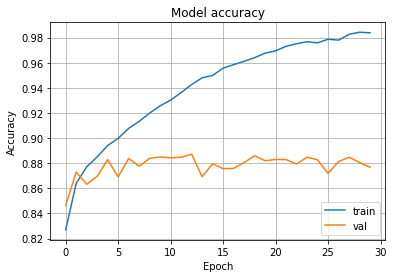

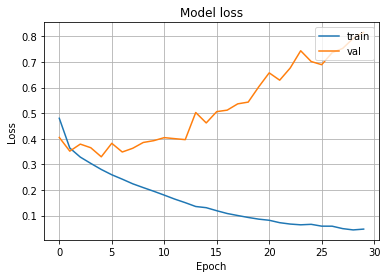

In [49]:
# summarize history for accuracy
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc='lower right')
plt.grid()
plt.show()
# summarize history for loss
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['train', 'val'], loc='upper right')
plt.grid()
plt.show()